In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import io,img_as_float,feature

## FEATURE DETECTION AND EXTRACTION

# 1) corner_foerstner
A fast operator for detection and precise location of distinct points, corners and centres of circular features

In [4]:
img=io.imread("M51whirlpool.jpeg")

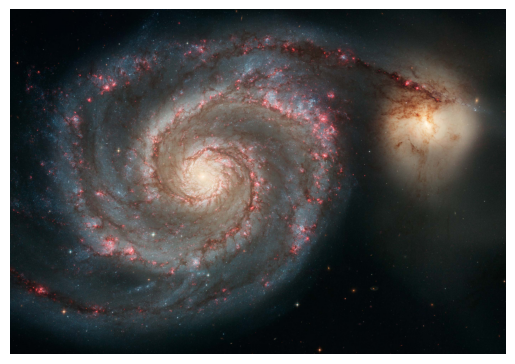

In [10]:
plt.imshow(img);
plt.axis('off');

In [11]:
img

array([[[ 1,  5,  8],
        [ 1,  5,  8],
        [ 0,  5,  9],
        ...,
        [ 8, 13, 16],
        [ 6, 11, 14],
        [ 4,  9, 12]],

       [[ 1,  5,  8],
        [ 1,  5,  8],
        [ 0,  5,  9],
        ...,
        [ 7, 12, 15],
        [ 6, 11, 14],
        [ 5, 10, 13]],

       [[ 1,  5,  8],
        [ 1,  5,  8],
        [ 0,  5,  9],
        ...,
        [ 5, 10, 13],
        [ 5, 10, 13],
        [ 5, 10, 13]],

       ...,

       [[ 2,  6,  9],
        [ 2,  6,  9],
        [ 2,  6,  9],
        ...,
        [ 3, 13, 14],
        [ 3, 13, 14],
        [ 3, 13, 14]],

       [[ 2,  6,  9],
        [ 2,  6,  9],
        [ 2,  6,  9],
        ...,
        [ 4, 14, 15],
        [ 4, 14, 15],
        [ 4, 14, 15]],

       [[ 2,  6,  9],
        [ 2,  6,  9],
        [ 2,  6,  9],
        ...,
        [ 4, 14, 15],
        [ 4, 14, 15],
        [ 4, 14, 15]]], dtype=uint8)

In [7]:
img.shape

(1936, 2784, 3)

In [12]:
img=io.imread('M51whirlpool.jpeg',as_gray=True)

In [13]:
img

array([[0.01712275, 0.01712275, 0.01657216, ..., 0.04766196, 0.03981882,
        0.03197569],
       [0.01712275, 0.01712275, 0.01657216, ..., 0.04374039, 0.03981882,
        0.03589725],
       [0.01712275, 0.01712275, 0.01657216, ..., 0.03589725, 0.03589725,
        0.03589725],
       ...,
       [0.02104431, 0.02104431, 0.02104431, ..., 0.0429298 , 0.0429298 ,
        0.0429298 ],
       [0.02104431, 0.02104431, 0.02104431, ..., 0.04685137, 0.04685137,
        0.04685137],
       [0.02104431, 0.02104431, 0.02104431, ..., 0.04685137, 0.04685137,
        0.04685137]])

In [14]:
featured_img=feature.corner_foerstner(img)

In [15]:
featured_img

(array([[0.00040349, 0.00040503, 0.00012449, ..., 0.00090478, 0.00197824,
         0.00184704],
        [0.00039925, 0.00045861, 0.00017785, ..., 0.00132051, 0.00256452,
         0.00201408],
        [0.00012087, 0.00017305, 0.00012104, ..., 0.0011195 , 0.00137595,
         0.00073704],
        ...,
        [0.00018464, 0.00026685, 0.00018571, ..., 0.00090463, 0.0014216 ,
         0.00101191],
        [0.00060633, 0.00069732, 0.00026685, ..., 0.00125179, 0.00340998,
         0.00309791],
        [0.00060636, 0.00060633, 0.00018464, ..., 0.00088858, 0.00296518,
         0.00304953]]),
 array([[0.82643238, 0.76392511, 0.2656006 , ..., 0.26438076, 0.61229028,
         0.69853679],
        [0.74170022, 0.97837282, 0.56026238, ..., 0.51840872, 0.90642843,
         0.71199844],
        [0.24775826, 0.52749224, 0.99895653, ..., 0.9176915 , 0.72834464,
         0.30403855],
        ...,
        [0.25053553, 0.53748157, 0.99902338, ..., 0.98385244, 0.63227303,
         0.31103524],
        [0.7

In [16]:
type(featured_img)  #it is a tuple of 2 arrays

tuple

In [17]:
len(featured_img)

2

In [18]:
featured_img[0].shape   #Error ellipse  (ERROR IMAGE)


(1936, 2784)

In [19]:
featured_img[1].shape #roundness of error ellipse (ROUND IMAGE)

(1936, 2784)

In [21]:
SPECTRAL_LIST = ["gray","jet","hot","prism","nipy_spectral"]

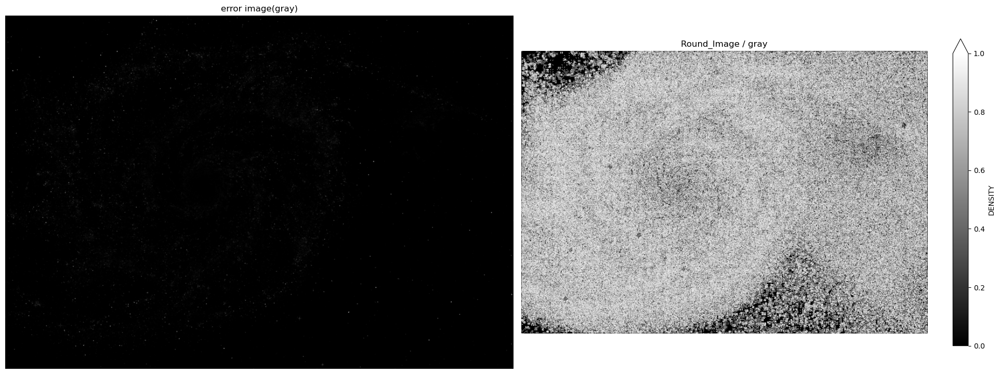

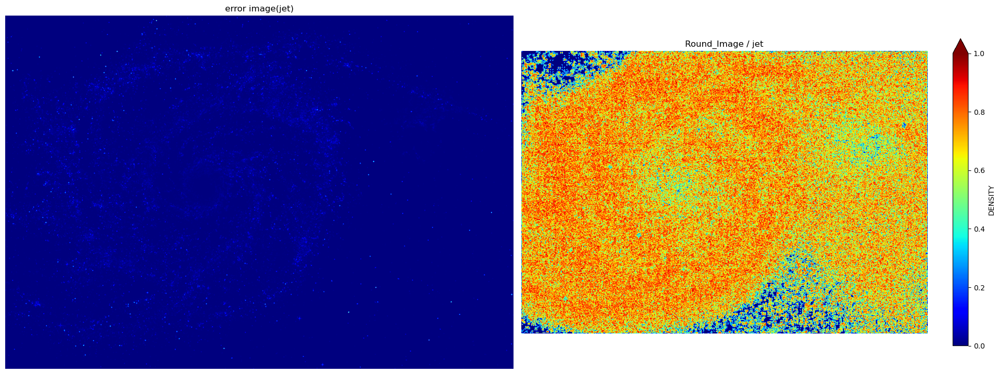

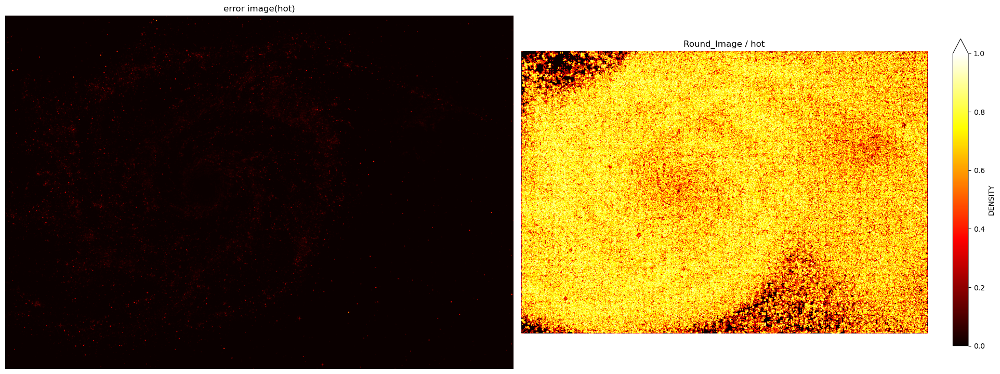

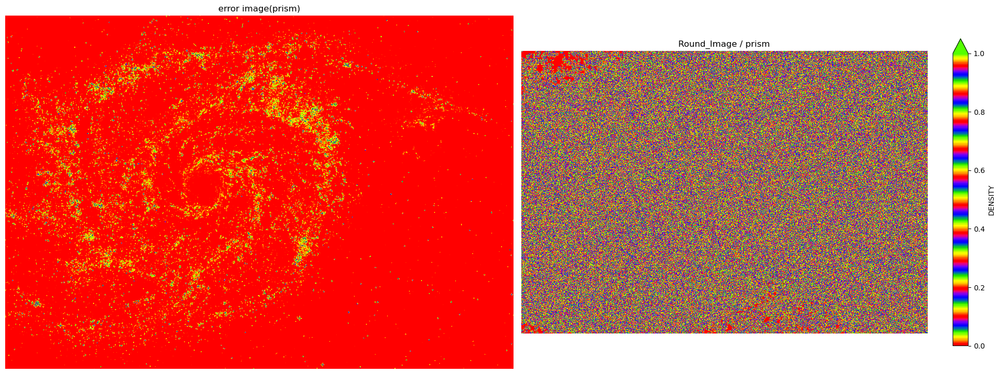

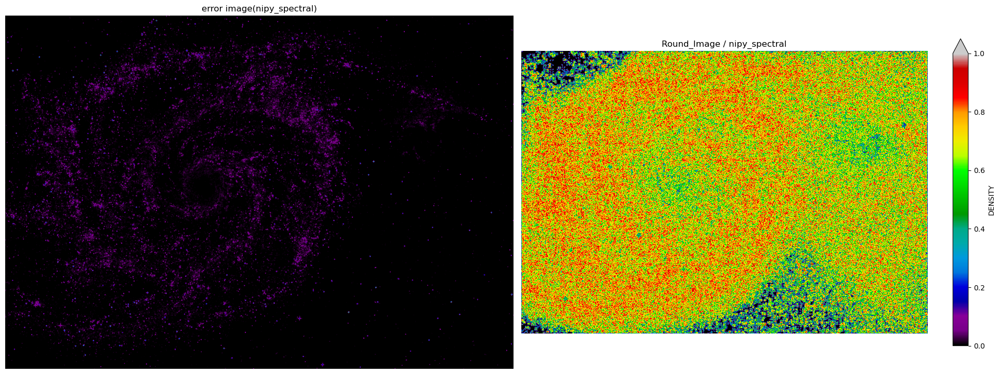

In [22]:
for x_spec in SPECTRAL_LIST:
    figure,axis=plt.subplots(1,2,figsize=(20,20))
    axis[0].imshow(featured_img[0],cmap=x_spec)
    axis[0].set_title("error image"+"("+x_spec+")")
    axis[0].axis("off")
    
    DENSITY_FUNC=axis[1].imshow(featured_img[1],cmap=x_spec)
    axis[1].set_title("Round_Image" + " / "+ x_spec)
    axis[1].axis("off")
    
    figure.colorbar(DENSITY_FUNC,shrink=0.3,label='DENSITY',extend="max")
    plt.tight_layout()
    plt.show()

# 2) canny
edge filter using the canny algorithm

In [27]:
featured_img=feature.canny(img)

In [28]:
type(featured_img)

numpy.ndarray

In [29]:
featured_img.shape

(1936, 2784)

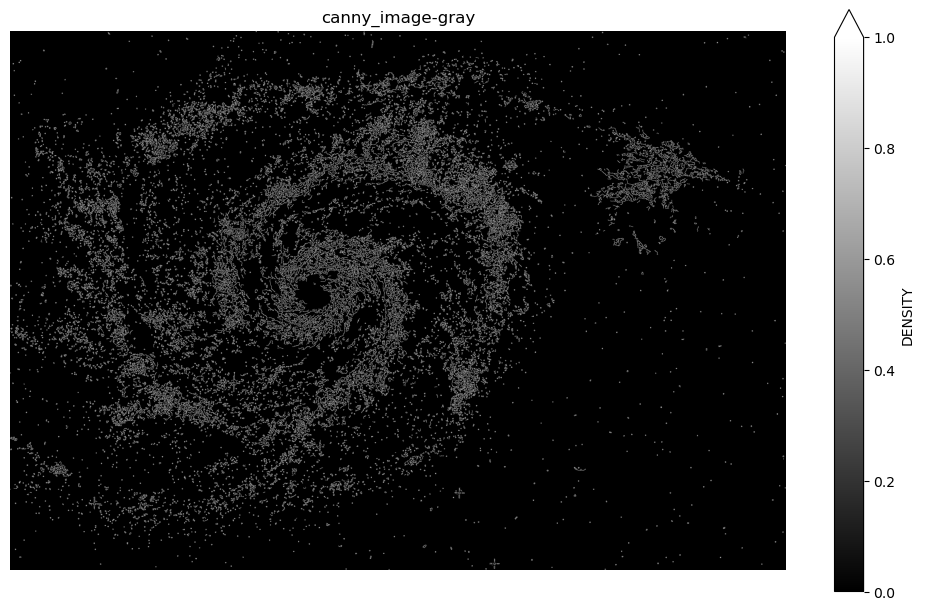

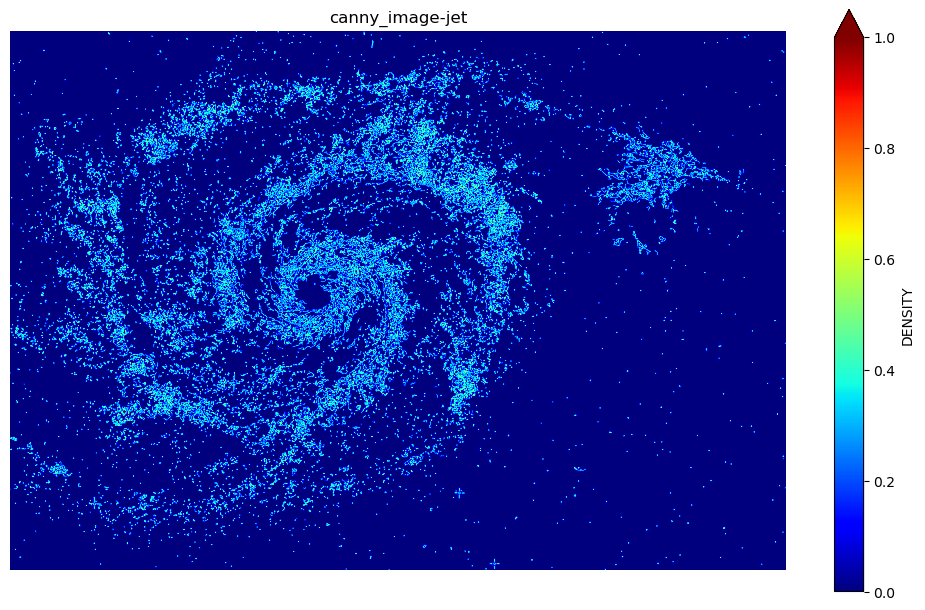

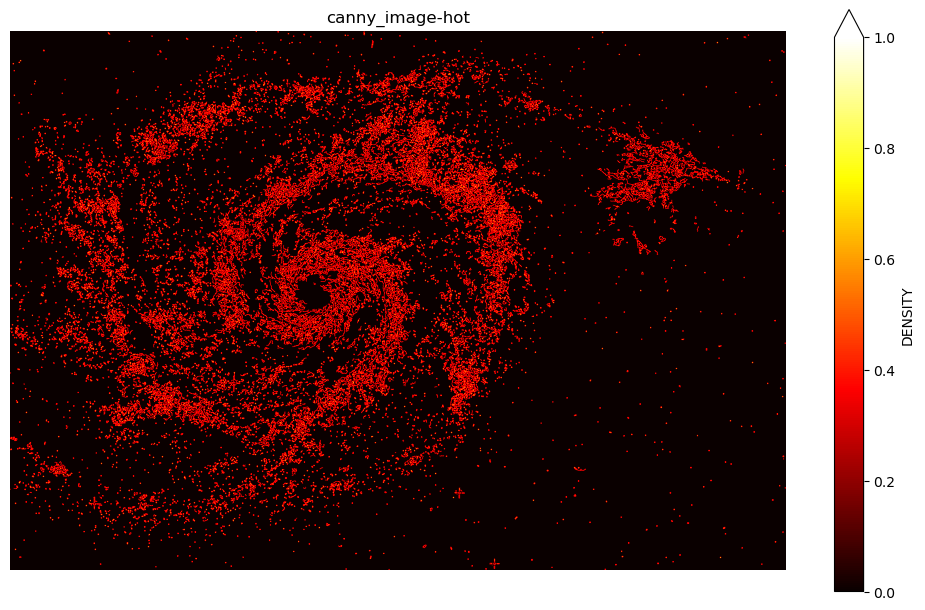

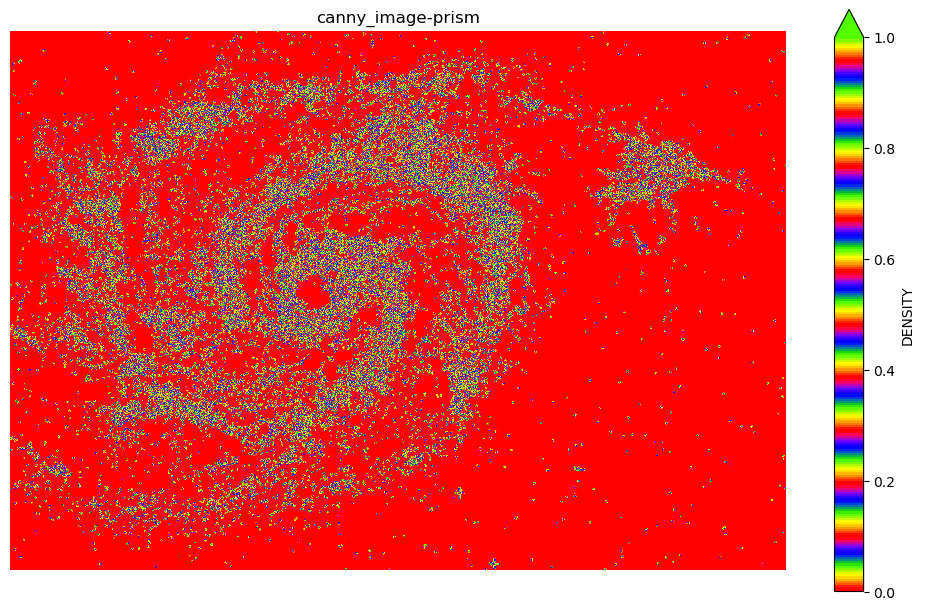

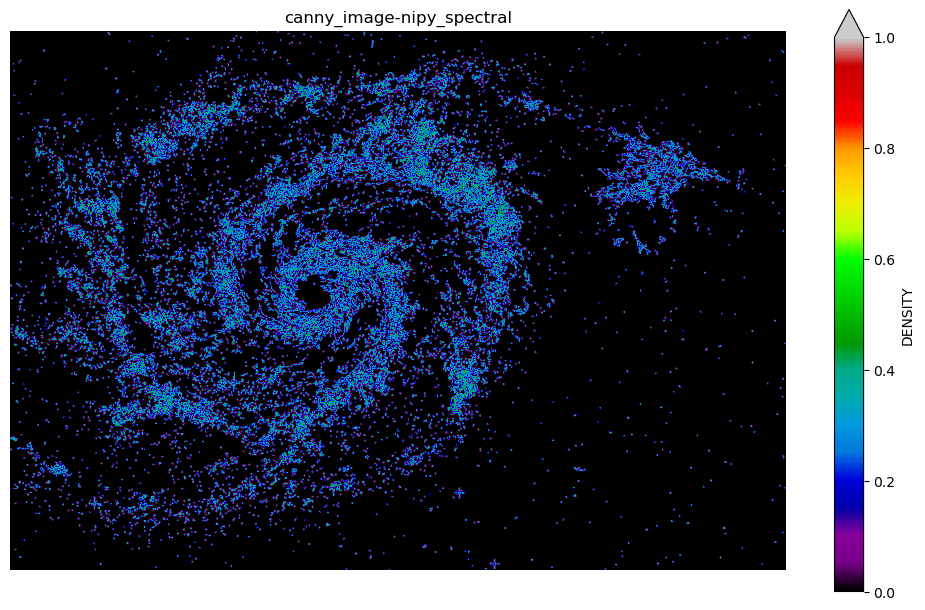

In [30]:
for x_spec in SPECTRAL_LIST:
    f=plt.figure()
    f.set_figwidth(10)
    f.set_figheight(10)
    plt.imshow(featured_img,cmap=x_spec)
    plt.title("canny_image"+"-"+x_spec)
    plt.axis('off')
    
    plt.tight_layout()
    plt.colorbar(shrink=0.6,label="DENSITY",extend='max')

# 3) multiscale_basic_features 
breaks image into multi sections (multi bands)

In [31]:
featured_img=feature.multiscale_basic_features(img)

In [32]:
featured_img.shape  # now we have 24 bands

(1936, 2784, 24)

In [33]:
import cv2

In [34]:
P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,P11,P12,P13,P14,P15,P16,P17,P18,P19,P20,P21,P22,P23,P24= cv2.split(featured_img) 



In [35]:
P1.shape

(1936, 2784)

In [36]:
P23.shape

(1936, 2784)

In [37]:
Pixels=[P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,P11,P12,P13,P14,P15,P16,P17,P18,P19,P20,P21,P22,P23,P24]



/var/folders/g7/627wzbxx3td29rg7f3r4zdrc0000gn/T/ipykernel_26169/2417919324.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f = plt.figure()


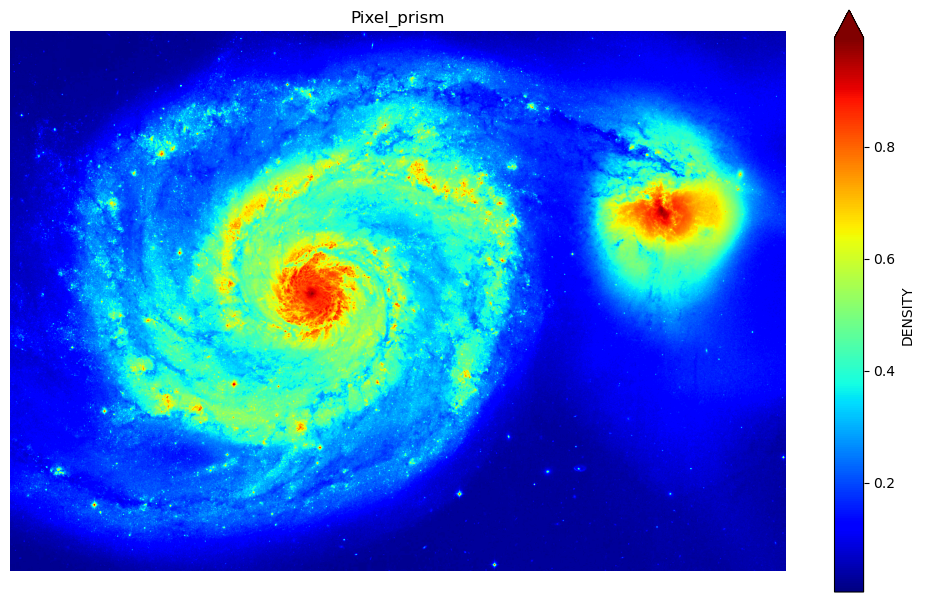

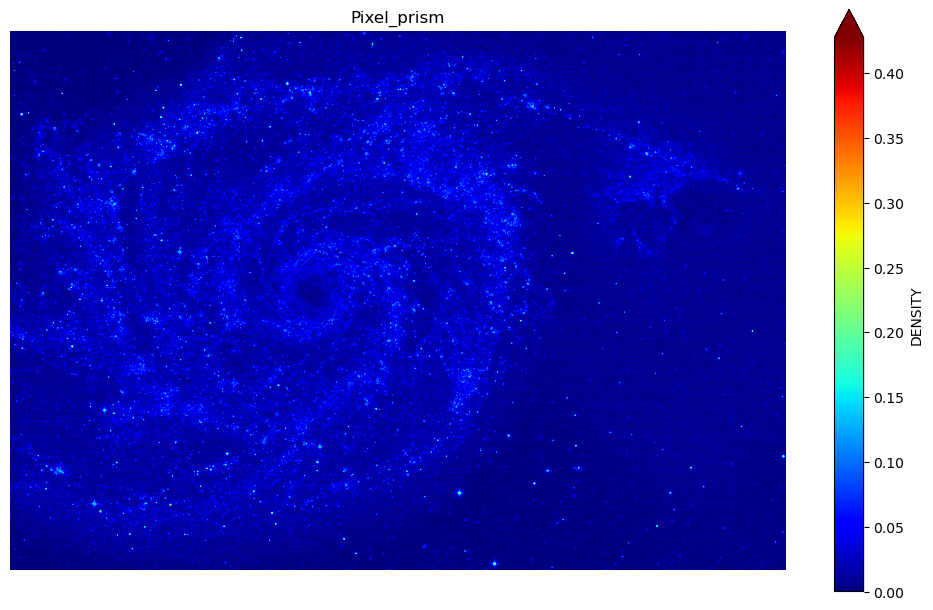

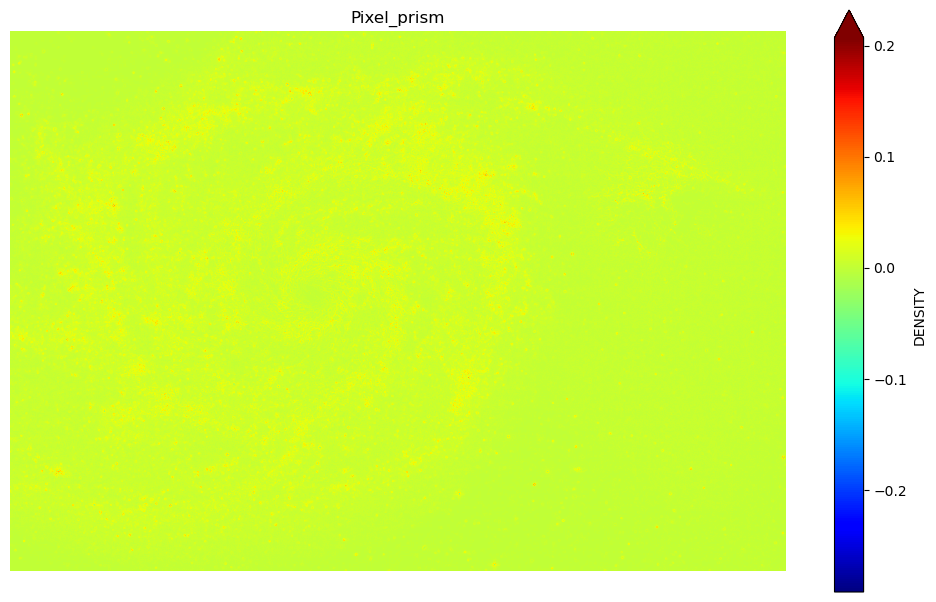

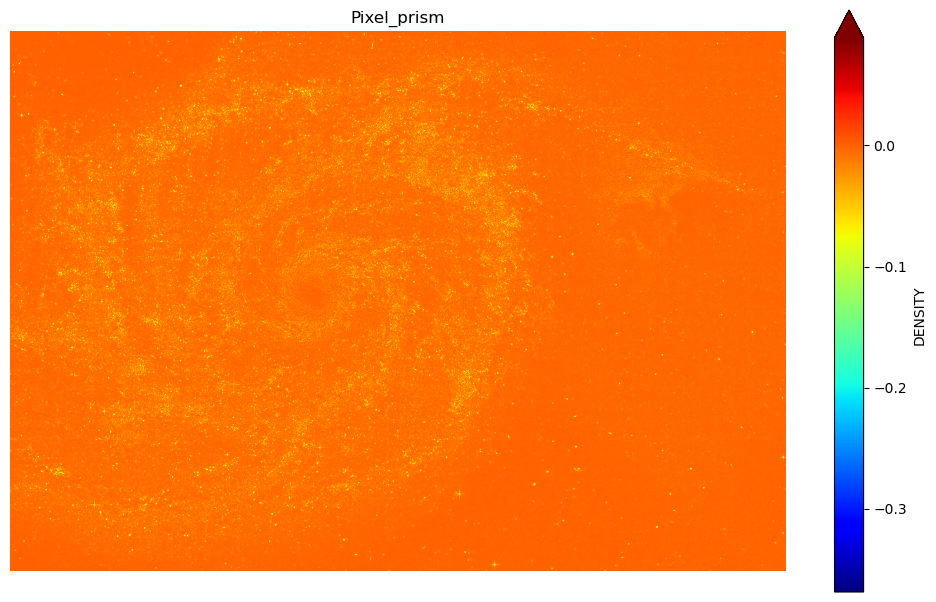

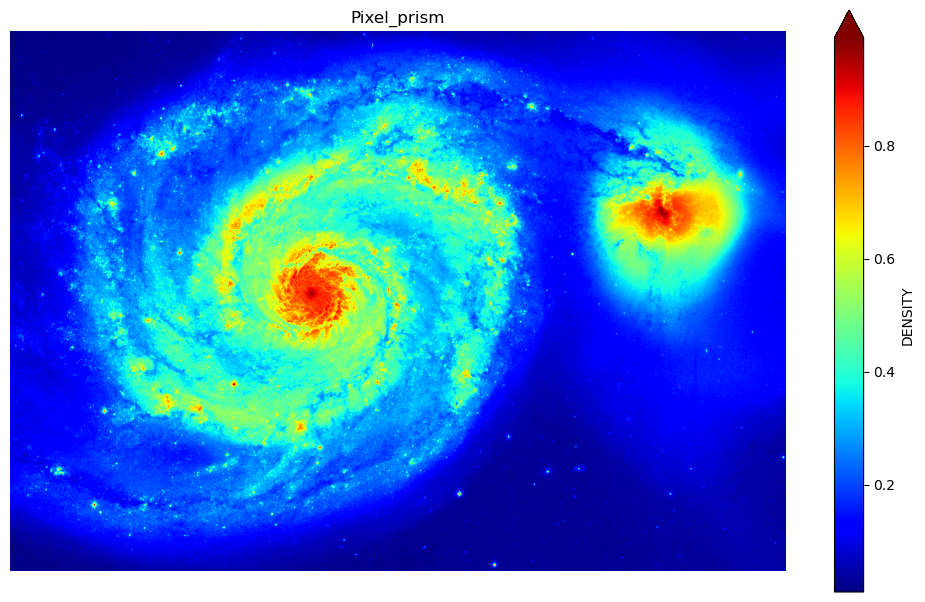

...

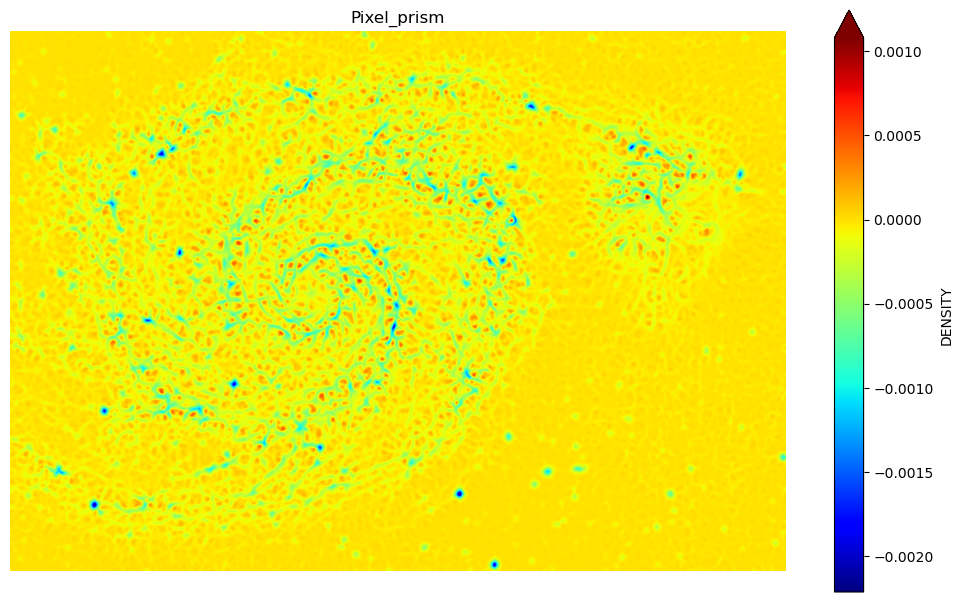

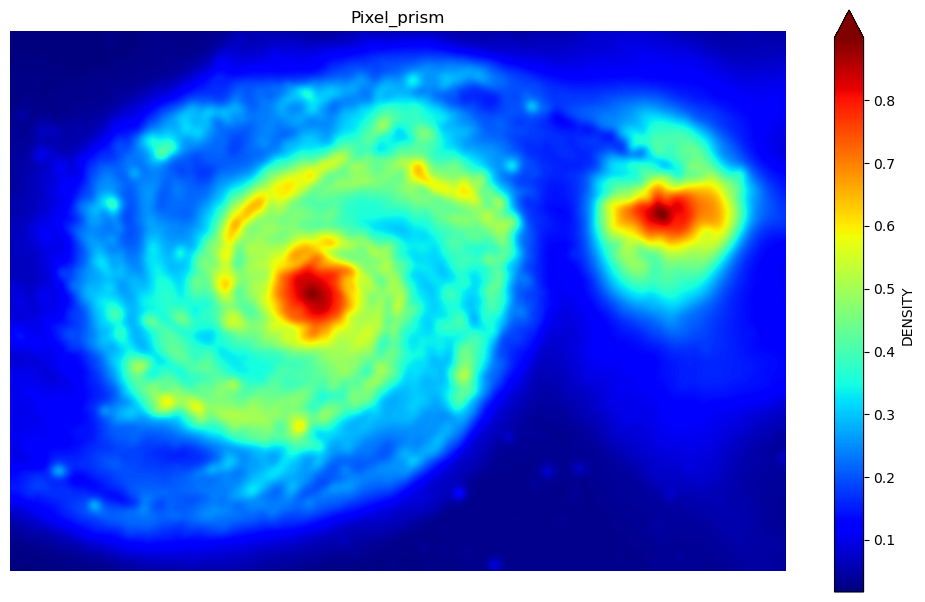

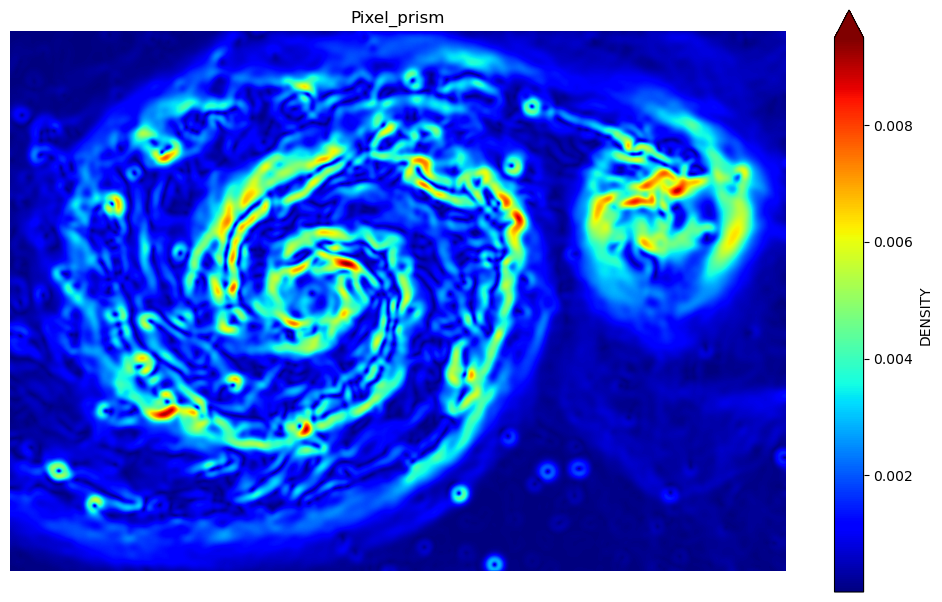

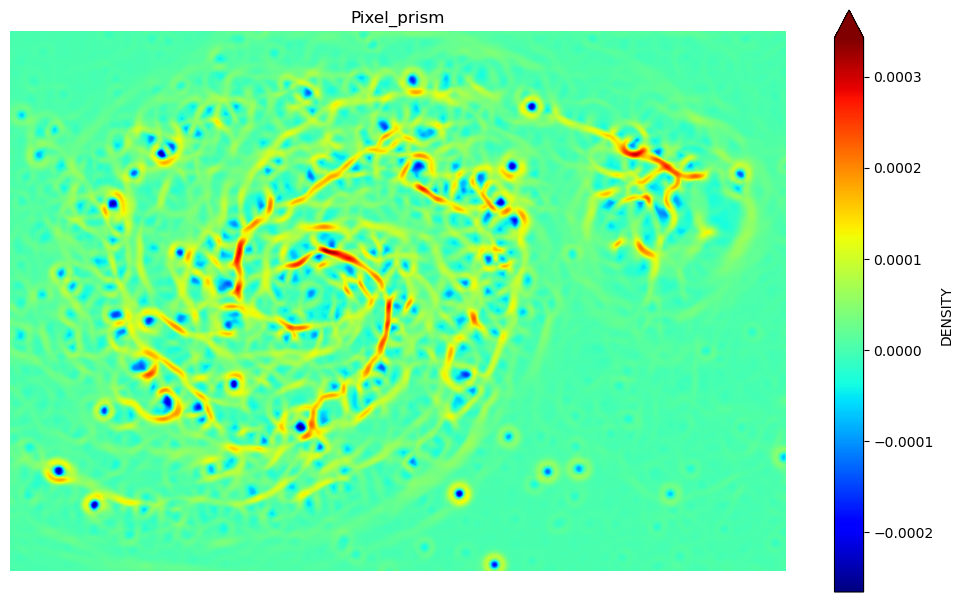

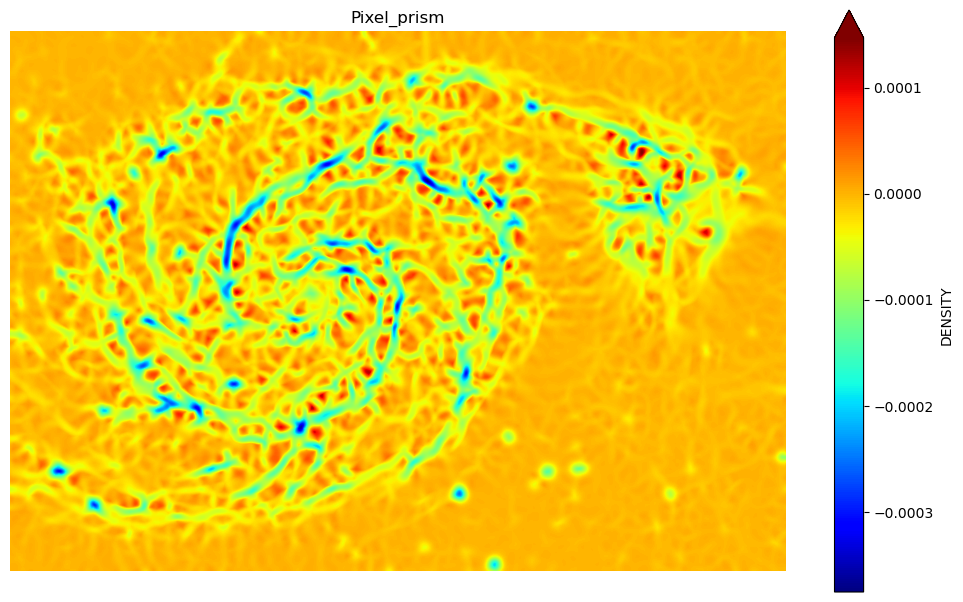

In [38]:
for pixel in Pixels:
    f = plt.figure()
    f.set_figwidth(10)
    f.set_figheight(10)
    plt.imshow(pixel,cmap = 'jet')
    plt.title("Pixel_prism")
    plt.axis("off")

    plt.tight_layout()
    plt.colorbar(shrink=0.6,label="DENSITY",extend="max");

 # 4) histogran of oriented gradient (HOG)
The Histogram of Oriented Gradient (HOG) feature descriptor is popular for object detection. 

In [39]:
from skimage.feature import hog
from skimage import exposure

In [46]:
hog_img=hog(img,orientations=8,pixels_per_cell=(12,12),cells_per_block=(3,3),visualize=True)


In [47]:
type(hog_img)

tuple

In [48]:
len(hog_img)

2

In [49]:
hog_img[1].shape

(1936, 2784)

In [50]:
hog_img=hog_img[1]

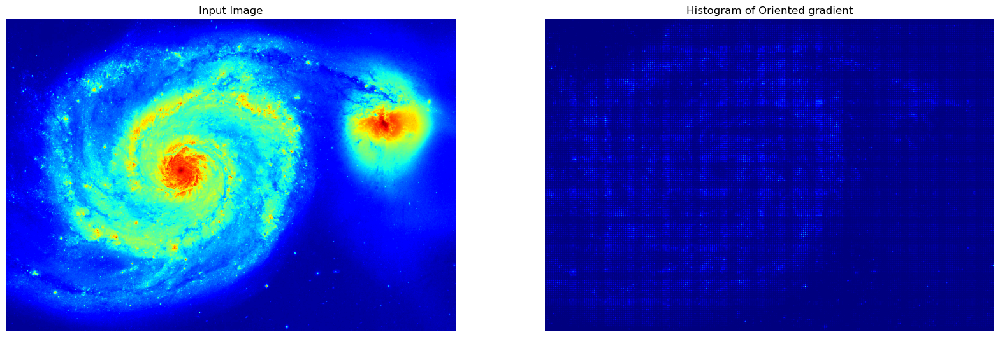

In [51]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(20,20),sharex=True,sharey=True)

ax1.axis('off')
ax1.imshow(img,cmap='jet')
ax1.set_title("Input Image")



#rescaled histogram
hog_img_rescaled=exposure.rescale_intensity(hog_img,in_range=(0,10))
ax2.axis('off')
ax2.imshow(hog_img_rescaled,cmap='jet')
ax2.set_title("Histogram of Oriented gradient");